# DriX: process raw TSG, navigation, meteorological data

Points to be resolved:

- few seconds delay between met station data and inertial station data


In [1]:
import os
from glob import glob

import numpy as np
import pandas as pd
import xarray as xr

%matplotlib inline
import matplotlib.pyplot as plt
import hvplot.xarray  # noqa
import hvplot.pandas  # noqa

import pynsitu as pin

crs = pin.maps.crs

C:\Tools\Miniconda3\envs\pynsitu\lib\site-packages\pyTMD\spatial.py:82: ImportWarning: GDAL not available
  warnings.warn("GDAL not available", ImportWarning)
<frozen importlib._bootstrap>:241: RuntimeWarning: numpy.ndarray size changed, may indicate binary incompatibility. Expected 16 from C header, got 96 from PyObject


In [2]:
campaign = "drixmed22"
root_dir = "/Users/aponte/Code/drix_analysis/" + campaign
yaml = f"{campaign}.yaml"

cp = pin.campaign(os.path.join(root_dir, yaml))
root_dir = os.path.join(cp.pathr, "DriX/")

kwargs_map = dict(extent=cp.lon + cp.lat, bathy=cp.bathy["label"])

AttributeError: module 'pynsitu' has no attribute 'campaign'

---

## load data

In [3]:
def _get_tstamp_dir(d):
    """get time stamp of directory"""
    day = d.split("/")[-1].split("_")[0]
    day = pd.Timestamp(year=int(day[:4]), month=int(day[4:6]), day=int(day[6:8]))
    return day


def _parser(l):
    if len(l) > 0:
        return ll2dec(l.split(";")[0], l.split(";")[1][:-1], l[-1])
    else:
        return np.NaN


def _emptystring2nan(s):
    if isinstance(s, str) and len(s) == 0:
        return np.NaN
    else:
        return s


def ll2dec(deg, minute, direction):
    if direction == "N" or direction == "E":
        sign = 1
    else:
        sign = -1
    return sign * (float(deg) + float(minute) / 60)


def read_drix_file(file, lon_key, lat_key):
    """load DriX txt data (logged with qinsy)"""

    with open(file, encoding="unicode_escape") as f:
        d = list(f.readlines())
        # replace return carriage from the end of the strings, split each string into a list
        d = [row.replace("\n", "").split(",") for row in d]

    # split in chunks if header changes
    D, C = [], []
    _d = []
    for row in d:
        if row[0] != "Date":
            # fill in data
            _d.append(row)
        else:
            # update column description
            C.append(row)
            if _d:
                D.append(_d)
                _d = []
    D.append(_d)

    DF = []
    for _d, _c in zip(D, C):
        df = pd.DataFrame(_d, columns=_c)
        # convert column 0 and 1 to a datetime
        df["time"] = pd.to_datetime(df["Date"] + " " + df["Time"])
        df.set_index("time", inplace=True)
        # parse coordinates
        df[lat_key + "_tmp"] = df[lat_key].map(_parser)
        df[lon_key + "_tmp"] = df[lon_key].map(_parser)
        # get rid of empty strings
        df = df.applymap(_emptystring2nan)
        # clean up
        df = df.drop(columns=["Date", "Time", lon_key, lat_key])
        df = df.rename(columns={lon_key + "_tmp": lon_key, lat_key + "_tmp": lat_key})
        DF.append(df)

    # convert all columns but index to float
    df = pd.concat(DF)
    for c in df:
        df[c] = df[c].astype(float)

    return df


def read_drix_data(root_dir, lon_key, lat_key):
    """Read a set of DriX files"""

    _dirs = sorted(glob(os.path.join(root_dir, "*")))
    dirs = pd.DataFrame(
        dict(dirs=_dirs),
        index=[[_get_tstamp_dir(d) for d in _dirs]],
    )

    files = []
    for d, s in dirs.iterrows():
        files = files + sorted(glob(os.path.join(s["dirs"], "Daily_Log/*.txt")))

    # dev
    # files = files[:2]

    # days = {d:d for d in dirs}
    # tstamps = [_get_tstamp(file) for file in files]
    # files = [f for f, t in zip(files, tstamps)
    #         if (t<=cp.end.ceil("d")) and (t>=cp.start.floor("d"))
    #        ]

    df = pd.concat([read_drix_file(f, lon_key, lat_key) for f in files])

    return df

---
## meteo

Data is 1Hz

Questions:

- where is "Station Meteo SOG" coming from, how is it computed?
- ...


In [4]:
meteo = read_drix_data(
    os.path.join(root_dir, "Station_Météo"),
    "Station Meteo Longitude",
    "Station Meteo Latitude",
)

meteo = meteo.rename(
    columns={
        "Temperature Value": "Temperature",
        "Relative Humidit": "Relative Humidity",
        "Solar Radiation Value": "Solar Radiation",
        "Pressure Value": "Pressure",
        "INS1_Gyro Value": "INS1_Gyro",
        "XTILT Value": "XTILT",
        "YTILT Value": "YTILT",
        "Compass Heading Value": "Compass Heading",
        "ZOrient Value": "ZOrient",
        "U Axis Value": "U Axis",
        "V Axis Value": "V Axis",
        "Volt Value": "Volt",
        "Windstat Value": "Windstat",
        "Status Value": "Status",
        "Station Meteo Longitude": "lon",
        "Station Meteo Latitude": "lat",
    }
)

meteo.columns

ValueError: No objects to concatenate

In [5]:
df = meteo

NameError: name 'meteo' is not defined

### compare Meteo compas and INS1 Gyro

There seem to be a lag of few seconds between the inertial station and the wind gauge

In [ ]:
df[["Compass Heading", "INS1_Gyro"]].hvplot()

Mean difference (compass-INS1) = -10.019 degrees


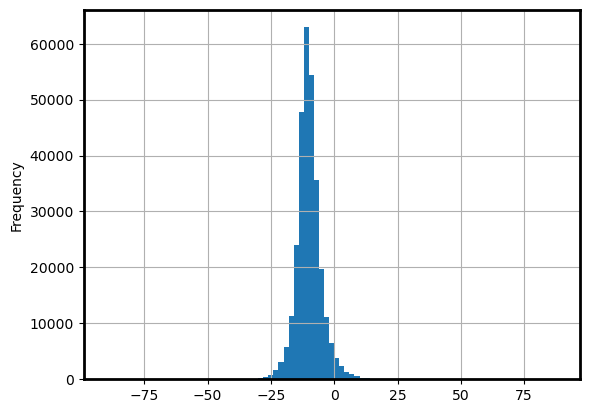

In [7]:
dphi = (df["Compass Heading"] - df["INS1_Gyro"] + 180) % 360 - 180
dphi.plot.hist(bins=np.arange(-90, 90, 2), grid=True)
print("Mean difference (compass-INS1) = {:.3f} degrees".format(dphi.mean()))

### compare geographical displacements and platform attitudes data (gyro ...)

In [8]:
df = df.geo.compute_velocities()

Rederiving velocity from coordinates is noisier than what is provided by the variable "Station Meteo SOG

Why ?

In [ ]:
df[["Station Meteo SOG", "velocity"]].hvplot()

One can approximately reconcile speed direction and INS1_Gyro, they are not expected to be equal (course vs heading)

In [ ]:
# direction is positive clockwise from north
df["speed_direction"] = (
    -np.arctan2(-df["velocity_east"], df["velocity_north"]) * 180 / np.pi
) % 360

_df = df.copy()
_df.loc[_df.velocity < 1] = np.NaN
_df[["INS1_Gyro", "speed_direction"]].hvplot()

Mean difference = -0.263 degrees


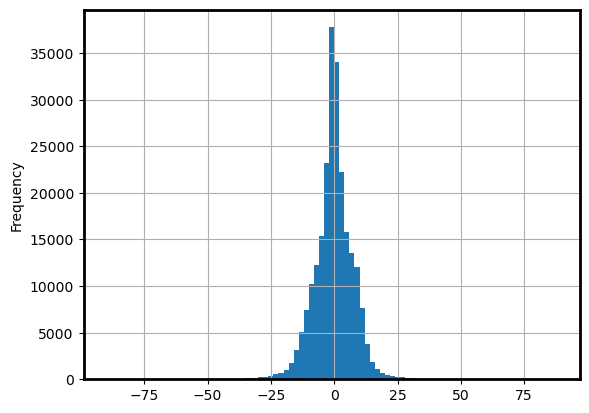

In [11]:
_df = df.copy()
_df.loc[_df.velocity < 1] = np.NaN

dphi = ((_df["speed_direction"] - _df["INS1_Gyro"]) + 180) % 360 - 180
dphi.plot.hist(bins=np.arange(-90, 90, 2), grid=True)

print("Mean difference = {:.3f} degrees".format(dphi.mean()))

### compute wind in geographic frame of reference

In [6]:
# rotates U Axis, V Axis into Earth coordinates first
# phi = "INS1_Gyro"
phi = "Compass Heading"
df["wind_u_relative"] = df["U Axis"] * np.sin(df[phi] / pin.rad2deg) - df[
    "V Axis"
] * np.cos(df[phi] / pin.rad2deg)
df["wind_v_relative"] = df["U Axis"] * np.cos(df[phi] / pin.rad2deg) + df[
    "V Axis"
] * np.sin(df[phi] / pin.rad2deg)

# correct for platform motion
u_met, v_met = "Station Meteo u", "Station Meteo v"
u_met, v_met = "velocity_east", "velocity_north"
df["wind_u_true"] = df["wind_u_relative"] + df[u_met]
df["wind_v_true"] = df["wind_v_relative"] + df[v_met]

NameError: name 'df' is not defined

In [7]:
df[["Station Meteo SOG", "U Axis", "wind_u_relative", "wind_u_true"]].hvplot(width=1000)

NameError: name 'df' is not defined

In [8]:
df[["V Axis", "wind_v_relative", "wind_v_true"]].hvplot(width=1000)

NameError: name 'df' is not defined

In [9]:
df["wind_u_true_low"] = df["wind_u_true"].rolling("10s", center=True).mean()
df["wind_v_true_low"] = df["wind_v_true"].rolling("10s", center=True).mean()

df["wind_u_true_prime"] = df["wind_u_true"] - df["wind_u_true_low"]
df["wind_v_true_prime"] = df["wind_v_true"] - df["wind_v_true_low"]

NameError: name 'df' is not defined

In [10]:
df[["wind_u_true", "wind_u_true_low"]].hvplot()

NameError: name 'df' is not defined

### try to highlight larger noise when Drix is going upwind

In [17]:
df["heading_relative"] = np.arctan2(df["U Axis"], df["V Axis"]) * pin.rad2deg
df["heading_relative_cut"] = pd.cut(df["heading_relative"], np.arange(-180, 185, 10))

In [18]:
dfn = (
    (df["wind_u_true_prime"] ** 2 + df["wind_v_true_prime"] ** 2)
    .groupby(df["heading_relative_cut"])
    .mean()
    .rename("noise")
    .to_frame()
    .reset_index()
)
dfn["heading_relative"] = dfn.reset_index()["heading_relative_cut"].map(lambda x: x.mid)
dfn = dfn.set_index("heading_relative").drop(columns="heading_relative_cut")

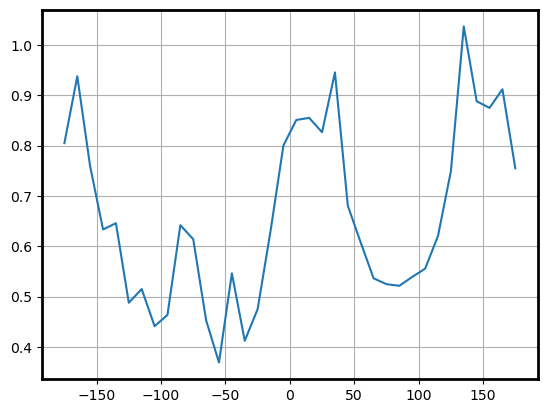

In [19]:
fig, ax = plt.subplots(1, 1)
ax.plot(dfn.index, dfn.noise)
ax.grid()
# dfn["noise"].plot(grid=True, ax=ax)
# ax.set_xlim((-180,180))

### store

In [20]:
_df = df.ts.resample_centered("10s").mean()
_df.to_xarray().to_netcdf(os.path.join(cp.pathp, "drix_met_10s.nc"), mode="w")

---
## underway CTDs

In [4]:
miniCT = read_drix_data(
    os.path.join(root_dir, "Mini_CT"), "MiniCT Longitude", "MiniCT Latitude"
)

miniCT = miniCT.rename(
    columns={
        "MiniCT Height": "height",
        "MiniCT Latitude": "lat",
        "MiniCT Longitude": "lon",
        "Conductivité Value": "conductivity",
        "Temperature Value": "temp",
    }
)

miniCT.loc[:,"depth"] = 2.
miniCT.sw.update_eos()

some values of longitude and latitudes are NaN, you may want to fill in with correct values


In [5]:
legato = read_drix_data(
    os.path.join(root_dir, "CTD_Legato"), "CTD RBR Longitude", "CTD RBR Latitude"
)

legato = legato.rename(
    columns={
        "CTD RBR Height": "height",
        "CTD RBR Latitude": "lat",
        "CTD RBR Longitude": "lon",
        "Conductivity Value": "conductivity",
        "Temperature Value": "temp",
        "Pressure Value": "pressure",
        "Sea Pressure Value": "sea level pressure",
        "Depth Value": "depth",
        "Salinity Value": "salinity",
        "Count Value": "count",
        "Temp Corr Value": "temp_corr",
    }
)

legato.sw.update_eos()

some values of longitude and latitudes are NaN, you may want to fill in with correct values


<AxesSubplot: xlabel='conductivity_ref', ylabel='correction'>

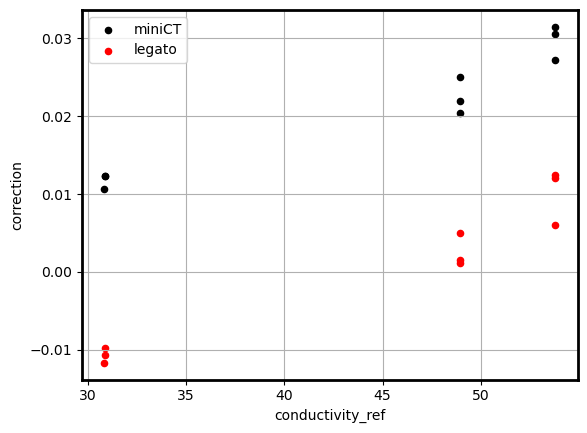

In [6]:
# sensor corrections (lab measured)
miniCT_eT = pd.DataFrame(
    dict(temperature_ref=[24.8991, 20.0087, 15.1941], 
         temperature_sensor=[24.8809, 19.9911, 15.1791],
         correction=[0.0182, 0.0176, 0.0150]),  # ref - sensor
)
    
miniCT_eC = pd.DataFrame(
    dict(salinity_ref=[24.1661, 24.1696, 24.1701, 35.4521, 35.4567, 35.4554, 35.1430, 35.1492, 35.1521], 
         temperature_bath=[15.1518, 15.1563, 15.1537, 20.4748, 20.4711, 20.4714, 25.4870, 25.4884, 25.4895], 
         conductivity_ref=[30.8529, 30.8602, 30.8589, 48.9579, 48.9597, 48.9584, 53.7752, 53.7852, 53.7902], 
         conductivity_sensor=[30.8421, 30.8479, 30.8466, 48.9375, 48.9346, 48.9364, 53.7481, 53.7537, 53.7595],
         correction=[0.0107, 0.0123, 0.0123, 0.0204, 0.0251, 0.0219, 0.0272, 0.0315, 0.0306]),  # ref - sensor
)

legato_eT = pd.DataFrame(
    dict(temperature_ref=[24.8991, 20.0087, 15.1941], 
         temperature_sensor=[24.9010, 20.0107, 15.1976],
         correction=[-0.0019, -0.0020, -0.0035]),  # ref - sensor
)
    
legato_eC = pd.DataFrame(
    dict(salinity_ref=[24.1661, 24.1696, 24.1696, 35.4521, 35.4567, 35.4554, 35.1430, 35.1492, 35.1521], 
         temperature_bath=[15.152, 15.156, 15.154, 20.4748, 20.4711, 20.4714, 25.4870, 25.4884, 25.4895], 
         conductivity_ref=[30.8529, 30.8602, 30.8589, 48.9579, 48.9597, 48.9584, 53.7752, 53.7852, 53.7902], 
         conductivity_sensor=[30.8645, 30.8700, 30.8691, 48.9568, 48.9547, 48.9569, 53.7692, 53.7726, 53.7782],
         correction=[-0.0117, -0.0098, -0.0107, 0.0011, 0.0050, 0.0015, 0.0060, 0.0125, 0.0120]),  # ref - sensor
)

fig, ax = plt.subplots(1,1)
miniCT_eC.plot.scatter(ax=ax,x="conductivity_ref", y="correction", grid=True, label="miniCT", color="k")
legato_eC.plot.scatter(ax=ax,x="conductivity_ref", y="correction", grid=True, label="legato", color="r")

In [7]:
from scipy import interpolate

def correct_temp(temp, sensor):
    """ return correction to temperature measurement"""
    if sensor=="miniCT":
        df = miniCT_eT
    elif sensor=="legato":
        df = legato_eT
    interp = interpolate.interp1d(df["temperature_ref"], 
                                  df["correction"], 
                                  kind="linear", 
                                  bounds_error=True,
                                 )
    correction = interp(temp)
    return correction


_conductivity_intervals = pd.IntervalIndex.from_tuples([(30,31), (48, 49), (53,54)])

def correct_conductivity(conductivity, sensor):
    """ return correction to conductivity measurement"""
    if sensor=="miniCT":
        df = miniCT_eC.copy()
    elif sensor=="legato":
        df = legato_eC.copy()
    df["conductivity"] = pd.cut(df["conductivity_ref"], _conductivity_intervals)
    dfm = df.groupby("conductivity").mean()
    interp = interpolate.interp1d(dfm["conductivity_ref"], 
                                  dfm["correction"], 
                                  kind="linear", 
                                  bounds_error=False,
                                  fill_value="extrapolate",
                                 )
    correction = interp(conductivity)
    return correction



In [8]:
# compute temperature corrections
miniCT["temp_correction"] = correct_temp(miniCT["temp"], "miniCT")
legato["temp_correction"] = correct_temp(legato["temp"], "legato")

# compute conductivity corrections
miniCT["conductivity_correction"] = correct_conductivity(miniCT["conductivity"], "miniCT")
legato["conductivity_correction"] = correct_conductivity(legato["conductivity"], "legato")

# apply corrections
miniCT = miniCT.rename(columns=dict(temp="temp_uncorrected", conductivity="conductivity_uncorrected"))
miniCT["temp"] = miniCT["temp_uncorrected"] + miniCT["temp_correction"]
miniCT["conductivity"] = miniCT["conductivity_uncorrected"] + miniCT["conductivity_correction"]

legato = legato.rename(columns=dict(temp="temp_uncorrected", conductivity="conductivity_uncorrected"))
legato["temp"] = legato["temp_uncorrected"] + legato["temp_correction"]
legato["conductivity"] = legato["conductivity_uncorrected"] + legato["conductivity_correction"]

In [9]:
_legato = legato.ts.resample_centered("1s").mean()
_miniCT = miniCT.ts.resample_centered("1s").mean()

uctd = pd.merge(_legato, _miniCT, on="time", suffixes=("_legato", "_miniCT"))
uctd = uctd.rename(columns=dict(lon_legato="lon", lat_legato="lat"))

In [10]:
uctd.to_xarray().to_netcdf(os.path.join(cp.pathp, "drix_underway_ctd_1s.nc"), mode="w")
uctd.ts.resample_centered("10s").mean().to_xarray().to_netcdf(
    os.path.join(cp.pathp, "drix_underway_ctd_10s.nc"), mode="w"
)

In [11]:
uctd.head()

,height_legato,conductivity_uncorrected_legato,temp_uncorrected_legato,pressure_legato,sea level pressure,depth_legato,salinity_legato,count,temp_corr,lat,...,depth_miniCT,pressure_miniCT,salinity_miniCT,SA_miniCT,CT_miniCT,sigma0_miniCT,temp_correction_miniCT,conductivity_correction_miniCT,temp_miniCT,conductivity_miniCT
time,,,,,,,,,,,,,,,,,,,,,
2022-09-21 12:00:16,46.07305,55.95110,23.71420,12.23145,2.09895,2.08180,38.23200,1.0,23.77925,42.993274,...,2.0,2.016045,38.279400,38.461919,23.577292,26.219075,0.018053,0.033112,23.716653,56.028012
2022-09-21 12:00:17,46.08830,55.93265,23.70780,12.10470,1.97220,1.95610,38.22330,1.0,23.74940,42.993262,...,2.0,2.016045,38.283387,38.465924,23.572426,26.223511,0.018052,0.033112,23.711919,56.027868
2022-09-21 12:00:18,45.96370,55.95705,23.70795,12.16865,2.03615,2.01955,38.24205,1.0,23.74935,42.993249,...,2.0,2.016045,38.286104,38.468655,23.579503,26.223425,0.018053,0.033130,23.719113,56.039470
2022-09-21 12:00:19,45.88665,55.96085,23.71870,12.15555,2.02305,2.00655,38.23565,1.0,23.70460,42.993240,...,2.0,2.016045,38.285185,38.467732,23.587028,26.220485,0.018054,0.033141,23.726624,56.046711
2022-09-21 12:00:20,45.61780,55.96265,23.72140,12.26430,2.13180,2.11440,38.23465,1.0,23.77925,42.993231,...,2.0,2.016045,38.284496,38.467040,23.588879,26.219416,0.018054,0.033142,23.728454,56.047872


### compare both CTDs

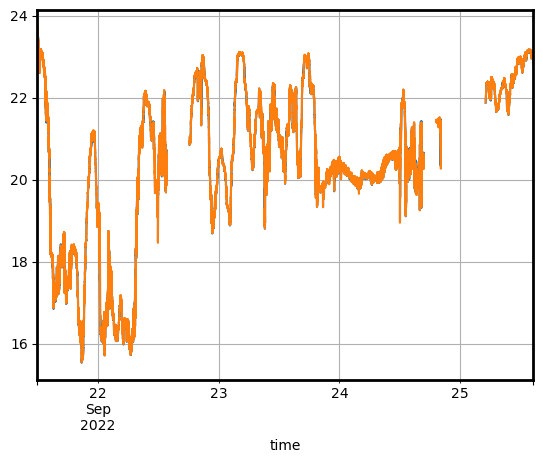

In [12]:
fig, ax = plt.subplots(1, 1)
uctd["temp_legato"].plot()
uctd["temp_miniCT"].plot()
ax.grid(which="both")

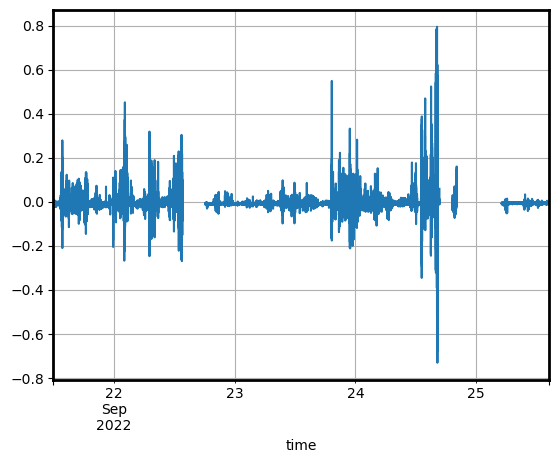

In [13]:
fig, ax = plt.subplots(1, 1)
(uctd["temp_legato"] - uctd["temp_miniCT"]).plot()
ax.grid(which="both")

Text(0.5, 1.0, 'temperature: legato-miniCT')

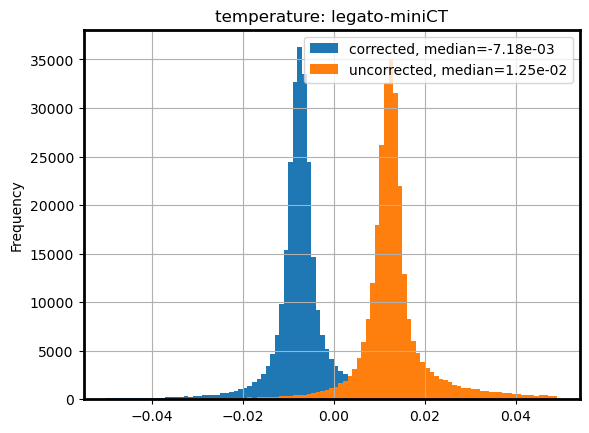

In [26]:
fig, ax = plt.subplots(1, 1)

vmax = 5*1e-2

_delta = (uctd["temp_legato"] - uctd["temp_miniCT"])
mean_delta = _delta.median()
_delta.plot.hist(bins=np.arange(-vmax, vmax, 1e-3), label=f"corrected, median={mean_delta:.2e}")

_delta = (uctd["temp_uncorrected_legato"] - uctd["temp_uncorrected_miniCT"])
mean_delta_uncorrected = _delta.median()
_delta.plot.hist(bins=np.arange(-vmax, vmax, 1e-3), label=f"uncorrected, median={mean_delta_uncorrected:.2e}")
ax.grid()
ax.legend()

ax.set_title(f"temperature: legato-miniCT")

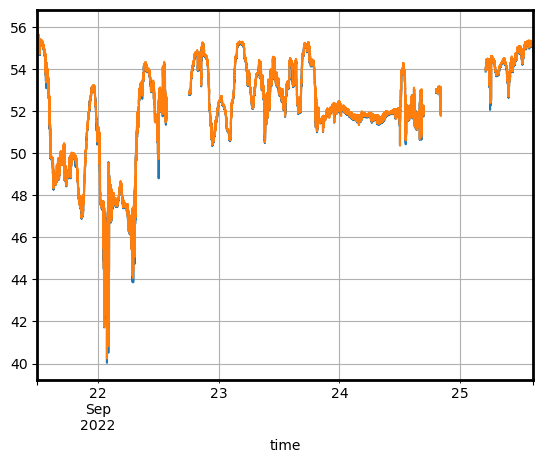

In [22]:
fig, ax = plt.subplots(1, 1)
uctd["conductivity_legato"].plot()
uctd["conductivity_miniCT"].plot()
ax.grid(which="both")

Text(0.5, 1.0, 'conductivity: legato-miniCT')

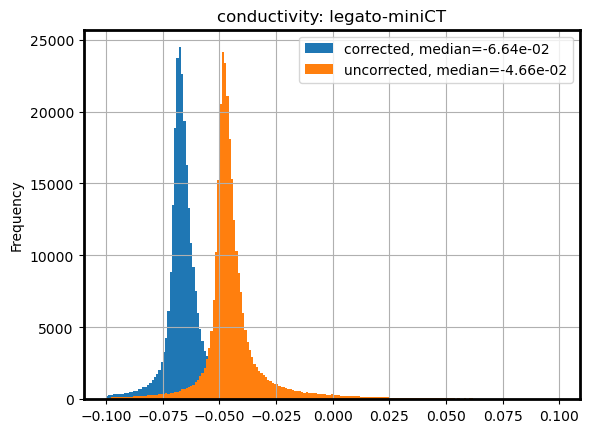

In [27]:
fig, ax = plt.subplots(1, 1)

vmax = 1e-1

_delta = (uctd["conductivity_legato"] - uctd["conductivity_miniCT"])
mean_delta = _delta.median()
_delta.plot.hist(bins=np.arange(-vmax, vmax, 1e-3), label=f"corrected, median={mean_delta:.2e}")

_delta = (uctd["conductivity_uncorrected_legato"] - uctd["conductivity_uncorrected_miniCT"])
mean_delta_uncorrected = _delta.median()
_delta.plot.hist(bins=np.arange(-vmax, vmax, 1e-3), label=f"uncorrected, median={mean_delta_uncorrected:.2e}")
ax.grid()
ax.legend()

ax.set_title(f"conductivity: legato-miniCT")

---
### inertial station

In [66]:
def load_ins_ascii(file, dt=None):

    # load
    df = pd.read_csv(
        file, delimiter="\t", encoding="iso-8859-1", skiprows=26
    )  # header=27 columns=[]
    df["time"] = pd.to_datetime(df["#date"] + " " + df["time"], errors="coerce")
    df = df.set_index("time").drop(columns=["#date"])

    # subsample
    if dt is not None:
        df = df.ts.resample_centered(dt).median()

    return df

In [ ]:
files = glob(os.path.join(root_dir, "INS/ascii/*.txt"))

dt = "10s"
df = pd.concat([load_ins_ascii(file, dt=dt) for file in files])
df.to_xarray().to_netcdf(os.path.join(cp.pathp, f"drix_ins_{dt}.nc"), mode="w")

---
## turbidity

Data is 2Hz

In [4]:
turb = read_drix_data(
    os.path.join(root_dir, "Turbidimètre"),
    "Turbidimètre Longitude",
    "Turbidimètre Latitude",
)

turb = turb.rename(
    columns={
        "Turbidimètre Height": "height",
        "Tension Value": "tension",
        "Temperature Value": "temperature",
        "V1 Value": "V1",
        "V2 Value": "V2",
        "Turbidimètre Longitude": "lon",
        "Turbidimètre Latitude": "lat",
    }
)

In [5]:
# from G037_OBS-3p_T8749_Calibration-Certificate_20180803.pdf
turb["turbidity_low_range"] = 1.0676e0 * turb["V1"]**2 + 4.3833e1 * turb["V1"] - 9.7576e-2
turb["turbidity_high_range"] = 2.3249e1 * turb["V2"]**2 + 1.6830e2 * turb["V2"] + 2.7114e-1

In [6]:
(turb["turbidity_low_range"].hvplot() + turb["turbidity_high_range"].hvplot()).cols(1)

:Layout
   .Curve.Turbidity_low_range  :Curve   [time]   (turbidity_low_range)
   .Curve.Turbidity_high_range :Curve   [time]   (turbidity_high_range)

In [21]:
df = turb

_df = df.ts.resample_centered("1s").mean()
_df.to_xarray().to_netcdf(os.path.join(cp.pathp, "drix_turb_1s.nc"), mode="w")

_df = df.ts.resample_centered("10s").mean()
_df.to_xarray().to_netcdf(os.path.join(cp.pathp, "drix_turb_10s.nc"), mode="w")

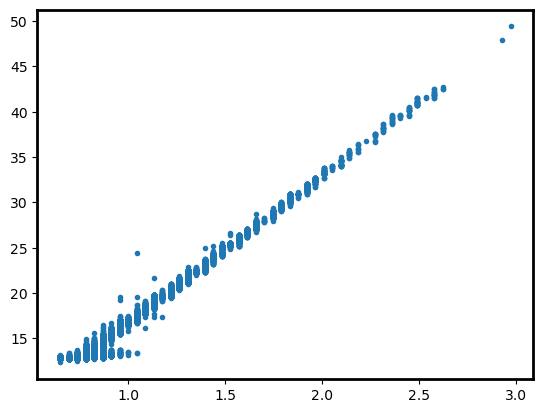

In [26]:
fig, ax = plt.subplots(1, 1)
ax.plot(turb["turbidity_low_range"], turb["turbidity_high_range"], ".")